<h1><span style="color: #6495ED;">Data Exploration</span></h1>

<h2><span style="color: #FF6F61;">Basic Analysis & EDA</span></h2> 

In [67]:
# %reset -f

<h3><span style="color: #008000;">Importing the required libraries</span></h3> 

In [68]:
import numpy as np
import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt
import missingno as msno
from statsmodels.tsa.seasonal import seasonal_decompose
import folium
from folium.plugins import HeatMap

In [69]:
# libraries required for the geospatial animation plot
from matplotlib.animation import FuncAnimation
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.feature import NaturalEarthFeature
import geopandas as gpd
from mpl_toolkits.axes_grid1 import make_axes_locatable
from folium.plugins import MarkerCluster
from IPython.display import HTML
from folium.plugins import MarkerCluster, TimestampedGeoJson
import os
from IPython.display import display

In [70]:
from IPython.display import FileLink

In [71]:
# read in our airquality dataset
columns_to_read = ["StationId", "Datetime", "PM2.5", "PM10", "NO", "NO2", "NOx", "NH3", "CO", "SO2", "O3", "Benzene", "Toluene", "Xylene", "AQI"]
df = pd.read_csv('data/ni_station_hourly.csv', usecols=columns_to_read)
df.head()

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
0,DL002,2017-10-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,DL002,2017-10-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,DL002,2017-10-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,DL002,2017-10-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,DL002,2017-10-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [72]:
df.shape

(451290, 15)

In [73]:
## AQI Categories
def get_AQI_bucket(x):
    if x <= 50:
        return "Good"
    elif x <= 100:
        return "Satisfactory"
    elif x <= 200:
        return "Moderate"
    elif x <= 300:
        return "Poor"
    elif x <= 400:
        return "Very Poor"
    elif x > 400:
        return "Severe"
    else:
        return np.NaN

df["AQI_Category"] = df["AQI"].apply(lambda x: get_AQI_bucket(x))
df.head()

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Category
0,DL002,2017-10-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,DL002,2017-10-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,DL002,2017-10-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,DL002,2017-10-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,DL002,2017-10-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [74]:
df.AQI_Category.value_counts()

AQI_Category
Moderate        130944
Very Poor       106058
Poor             68635
Satisfactory     60262
Severe           33995
Good              4983
Name: count, dtype: int64

Loading in the 19 Delhi stations' latitude and longitude that I manually got from Google

In [75]:
# Load station latitude and longitude
ni_stations_lat_lon = pd.read_csv('data/ni_stations_lat_lon.csv')
ni_stations_lat_lon.head()

,StationId,Lat,Lon
0,DL002,28.650179,77.302986
1,DL004,28.472728,77.132252
2,DL006,28.728763,77.197949
3,DL007,28.551865,77.275382
4,DL008,28.752428,77.129004


Merging the the latitude and logitude dataframe with our original dataframe

In [76]:
# Add latitude and longitude to the "df" dataframe
df = pd.merge(df, ni_stations_lat_lon, on='StationId', how='left')
df.head()

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Category,Lat,Lon
0,DL002,2017-10-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.650179,77.302986
1,DL002,2017-10-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.650179,77.302986
2,DL002,2017-10-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.650179,77.302986
3,DL002,2017-10-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.650179,77.302986
4,DL002,2017-10-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.650179,77.302986


In [77]:
df.shape

(451290, 18)

Converting Datetime column to Datetime format, and extracting "Year", "Month", "DayOfWeek", "HourOfDay" from it.

In [78]:
# Convert the 'Datetime' column to a pandas datetime object
df['Datetime'] = pd.to_datetime(df['Datetime'])

# Sort DataFrame by 'Datetime'
# df = df.sort_values(by='Datetime') # THIS SORTING HAS SOME ISSUE WHICH REMOVES TIME COMPONENT FROM DATETIME FIELD. INVESTIGATE THIS LATER.

# Extract year from the 'Datetime' column
df['Year'] = df['Datetime'].dt.year

# Add a new column 'Month' with month names
df['Month'] = df['Datetime'].dt.strftime('%B')

# Add a new column 'DayOfWeek'
df['DayOfWeek'] = df['Datetime'].dt.day_name()

# Add a new column 'HourOfDay'
df['HourOfDay'] = df['Datetime'].dt.hour

df.head()

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,...,Toluene,Xylene,AQI,AQI_Category,Lat,Lon,Year,Month,DayOfWeek,HourOfDay
0,DL002,2017-10-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,28.650179,77.302986,2017,October,Sunday,0
1,DL002,2017-10-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,28.650179,77.302986,2017,October,Sunday,1
2,DL002,2017-10-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,28.650179,77.302986,2017,October,Sunday,2
3,DL002,2017-10-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,28.650179,77.302986,2017,October,Sunday,3
4,DL002,2017-10-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,28.650179,77.302986,2017,October,Sunday,4


### Feature Engineering

Some of the helpful features that would help predict the aqi could be "Volatility over last 1 day", "Volatility over last 7 days", "Volatility over last 30 days", 'moving average of last 7 days', 'moving average of last 30 days', everything is calculated ove the "AQI" column.

In [79]:
# Calculate volatilities for daily, weekly, and monthly rolling windows per station
df['Volatility_Last1D'] = df.groupby('StationId')['AQI'].rolling(window=24).std().reset_index(level=0, drop=True)
df['Volatility_Last7D'] = df.groupby('StationId')['AQI'].rolling(window=24 * 7).std().reset_index(level=0, drop=True)
df['Volatility_Last30D'] = df.groupby('StationId')['AQI'].rolling(window=24 * 30).std().reset_index(level=0, drop=True)

# Calculate moving average for weekly, and monthly rolling windows per station
df['MA_Last7D'] = df.groupby('StationId')['AQI'].rolling(window=24 * 7).mean().reset_index(level=0, drop=True)
df['MA_Last30D'] = df.groupby('StationId')['AQI'].rolling(window=24 * 30).mean().reset_index(level=0, drop=True)

df.head()

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,...,Lon,Year,Month,DayOfWeek,HourOfDay,Volatility_Last1D,Volatility_Last7D,Volatility_Last30D,MA_Last7D,MA_Last30D
0,DL002,2017-10-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,77.302986,2017,October,Sunday,0,NaN,NaN,NaN,NaN,NaN
1,DL002,2017-10-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,77.302986,2017,October,Sunday,1,NaN,NaN,NaN,NaN,NaN
2,DL002,2017-10-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,77.302986,2017,October,Sunday,2,NaN,NaN,NaN,NaN,NaN
3,DL002,2017-10-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,77.302986,2017,October,Sunday,3,NaN,NaN,NaN,NaN,NaN
4,DL002,2017-10-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,77.302986,2017,October,Sunday,4,NaN,NaN,NaN,NaN,NaN


Checking Null values:

In [80]:
df.isna().sum()

StationId                  0
Datetime                   0
PM2.5                  49288
PM10                  145732
NO                     56187
NO2                    52197
NOx                    40494
NH3                   277922
CO                     49543
SO2                   224222
O3                     79979
Benzene               197707
Toluene               214337
Xylene                353715
AQI                    46413
AQI_Category           46413
Lat                        0
Lon                        0
Year                       0
Month                      0
DayOfWeek                  0
HourOfDay                  0
Volatility_Last1D      59878
Volatility_Last7D     123855
Volatility_Last30D    256744
MA_Last7D             123855
MA_Last30D            256744
dtype: int64

Plotting the Null values in all the columns using msno:

<Axes: >

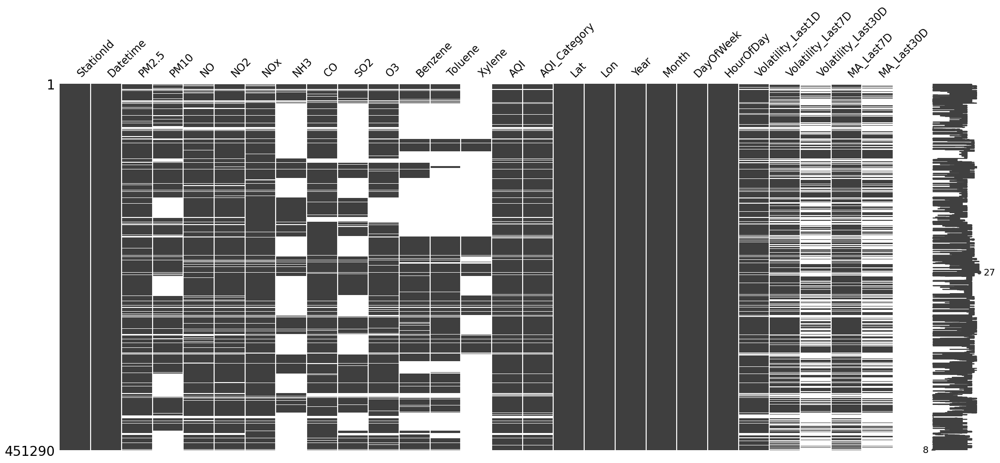

In [81]:
msno.matrix(df)

Analyzing missing values in "AQI" column for all the 19 stations using groupby

In [82]:
total_records = df.groupby('StationId').size().reset_index(name='TotalRecords')
missing_aqi_records = df[df['AQI'].isna()].groupby('StationId').size().reset_index(name='MissingAQIRecords')

# Merge the two results on StationId
result = pd.merge(total_records, missing_aqi_records, on='StationId', how='left').fillna(0)
result = result.sort_values(by='MissingAQIRecords', ascending=False).reset_index(drop=True)

result.head(50)

,StationId,TotalRecords,MissingAQIRecords
0,HR011,21912,4927
1,HR014,24097,4132
2,DL006,19729,4091
3,DL002,24097,3858
4,DL014,24097,3295
5,DL034,24097,3033
6,DL025,24097,2852
7,DL008,24097,2762
8,DL030,24097,2599
9,DL017,24097,2430


Plotting the missing values in the "AQI" column:

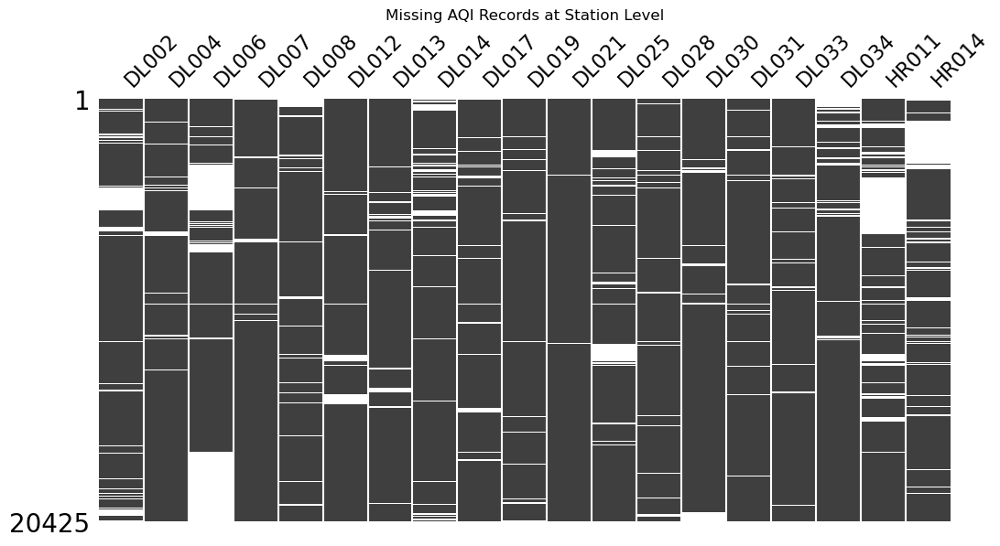

In [83]:
start_date = '2018-01-01'
end_date = '2020-05-01'
df_missing_aqi_at_station = df[(df['Datetime'] >= start_date) & (df['Datetime'] <= end_date)]
df_missing_aqi_at_station = df_missing_aqi_at_station.sort_values(by=['StationId', 'Datetime'], ascending=False).reset_index(drop=True)

# Create a matrix of missing values
missing_aqi_matrix = df_missing_aqi_at_station.pivot_table(index='Datetime', columns='StationId', values='AQI', aggfunc='max')

# Plot the matrix using missingno
msno.matrix(missing_aqi_matrix, figsize=(12, 6), sparkline=False, labels=True)
plt.title('Missing AQI Records at Station Level')
plt.show()

In [84]:
# DON'T DELETE 'NA' - 'AQI' RECORDS UNTIL ALL FEATURES REQUIRING HOURLY ROLLING WINDOW EXTRACTION ARE PROCESSED
df = df.dropna(subset=['AQI']).reset_index(drop=True)
df.head()

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,...,Lon,Year,Month,DayOfWeek,HourOfDay,Volatility_Last1D,Volatility_Last7D,Volatility_Last30D,MA_Last7D,MA_Last30D
0,DL002,2017-10-24 06:00:00,249.0,633.0,NaN,125.63,NaN,138.29,4.03,18.50,...,77.302986,2017,October,Tuesday,6,NaN,NaN,NaN,NaN,NaN
1,DL002,2017-10-24 07:00:00,241.0,919.0,NaN,115.41,NaN,138.75,3.53,32.34,...,77.302986,2017,October,Tuesday,7,NaN,NaN,NaN,NaN,NaN
2,DL002,2017-10-24 08:00:00,282.0,919.0,NaN,116.23,NaN,134.12,3.32,29.98,...,77.302986,2017,October,Tuesday,8,NaN,NaN,NaN,NaN,NaN
3,DL002,2017-10-24 09:00:00,267.0,782.0,NaN,117.22,412.65,125.42,2.91,17.09,...,77.302986,2017,October,Tuesday,9,NaN,NaN,NaN,NaN,NaN
4,DL002,2017-10-24 10:00:00,242.0,819.0,96.26,129.47,302.87,119.88,4.39,7.73,...,77.302986,2017,October,Tuesday,10,NaN,NaN,NaN,NaN,NaN


In [85]:
df['AQI'].isna().sum()

0

I will not actually drop the missing values in the "AQI" column since that is my target variable and this is a timeseries dataset.

**My plans on handling these missing values**

During the AQI calculation, for the pollutant values where the AQI couldn't be calculated due to missing/ insufficient pollutant measurements, the AQI values for those records were set as "NaN"

I am going to use the "Interpolation" method to fill in the missing values for the pollutants first then calculate the respective AQI using the previous calculation function, and this way the AQI missing values can be handled.

In [86]:
print(df['StationId'].unique())

['DL002' 'DL004' 'DL006' 'DL007' 'DL008' 'DL012' 'DL013' 'DL014' 'DL017'
 'DL019' 'DL021' 'DL025' 'DL028' 'DL030' 'DL031' 'DL033' 'DL034' 'HR011'
 'HR014']


In [87]:
# chart_df = df
stations_to_include = ['DL006', 'HR014', 'DL012']
chart_df = df[df['StationId'].isin(stations_to_include)].copy()
chart_df.reset_index(drop=True, inplace=True)

# Extract Year and Month from 'Datetime'
chart_df['Datetime'] = pd.to_datetime(chart_df['Datetime'])

# Create 'Year_Month' column with the 1st day of every month
chart_df['Datetime'] = chart_df['Datetime'].dt.to_period('M').dt.to_timestamp()

Creating a new dataframe for visualization:

Plot AQI for each station:

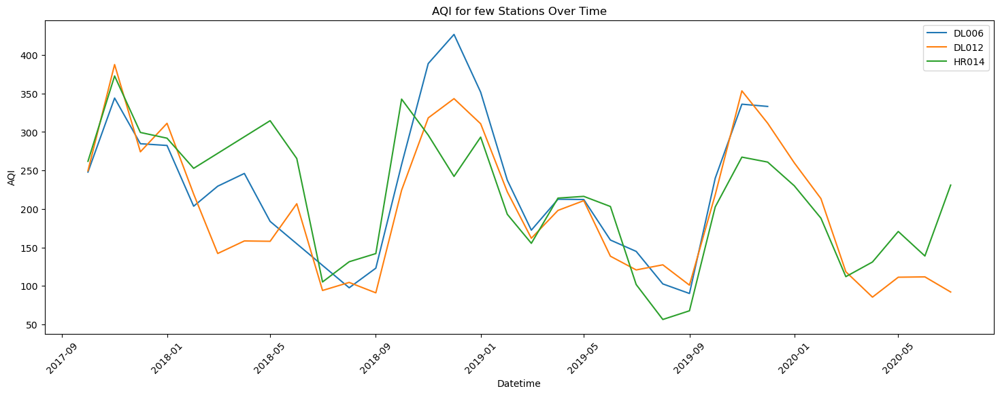

In [88]:
# Group by 'StationId' and 'Year_Month', calculate mean AQI
chart_df_2 = chart_df.groupby(['StationId', 'Datetime'])['AQI'].mean().reset_index()

# Create a line chart for each StationId
plt.figure(figsize=(18, 6))

# Plot AQI for each station
for station_id in chart_df_2['StationId'].unique():
    station_data = chart_df_2[chart_df_2['StationId'] == station_id]
    plt.plot(station_data['Datetime'], station_data['AQI'], label=station_id)

# Customize the plot
plt.title('AQI for few Stations Over Time')
plt.xlabel('Datetime')
plt.ylabel('AQI')
plt.xticks(rotation=45)
plt.legend()
plt.show()

plotting the column names 

In [89]:
chart_df.columns

Index(['StationId', 'Datetime', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3',
       'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI',
       'AQI_Category', 'Lat', 'Lon', 'Year', 'Month', 'DayOfWeek', 'HourOfDay',
       'Volatility_Last1D', 'Volatility_Last7D', 'Volatility_Last30D',
       'MA_Last7D', 'MA_Last30D'],
      dtype='object')

Correlation Matrix for the numerical features:

c:\Users\Braja\anaconda3\envs\timeseries\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)


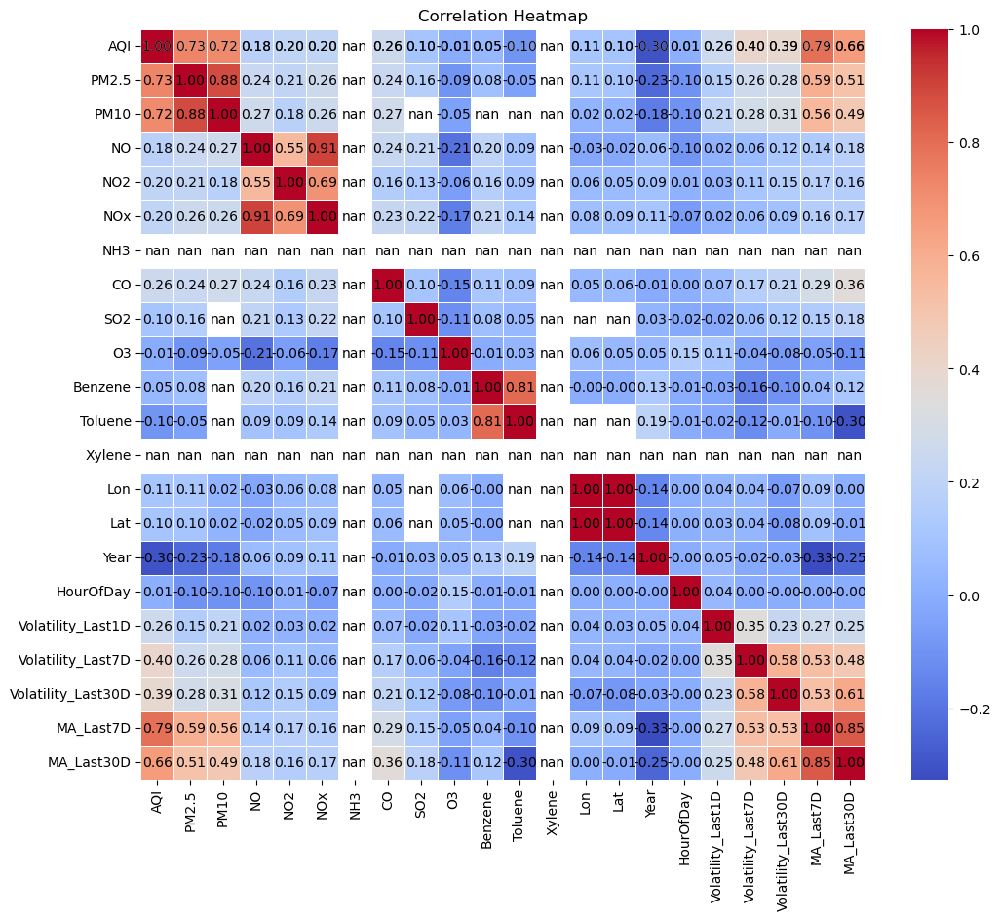

In [90]:
# Extract relevant columns for correlation heatmap
correlation_columns = ['AQI', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'Lon', 'Lat', 'Year', 'HourOfDay', 'Volatility_Last1D', 'Volatility_Last7D', 'Volatility_Last30D', 'MA_Last7D', 'MA_Last30D']

# Calculate the correlation matrix
correlation_matrix = chart_df[correlation_columns].corr()

# Set up the matplotlib figure
plt.figure(figsize=(12, 10))

# Create a heatmap
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', linewidths=.5)

# Manually annotate the values
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix.columns)):
        plt.text(j + 0.5, i + 0.5, f"{correlation_matrix.iloc[i, j]:.2f}", ha='center', va='center')

# Set title
plt.title('Correlation Heatmap')

# Show the plot
plt.show()

## Visualization:

Distribution of pollutants:

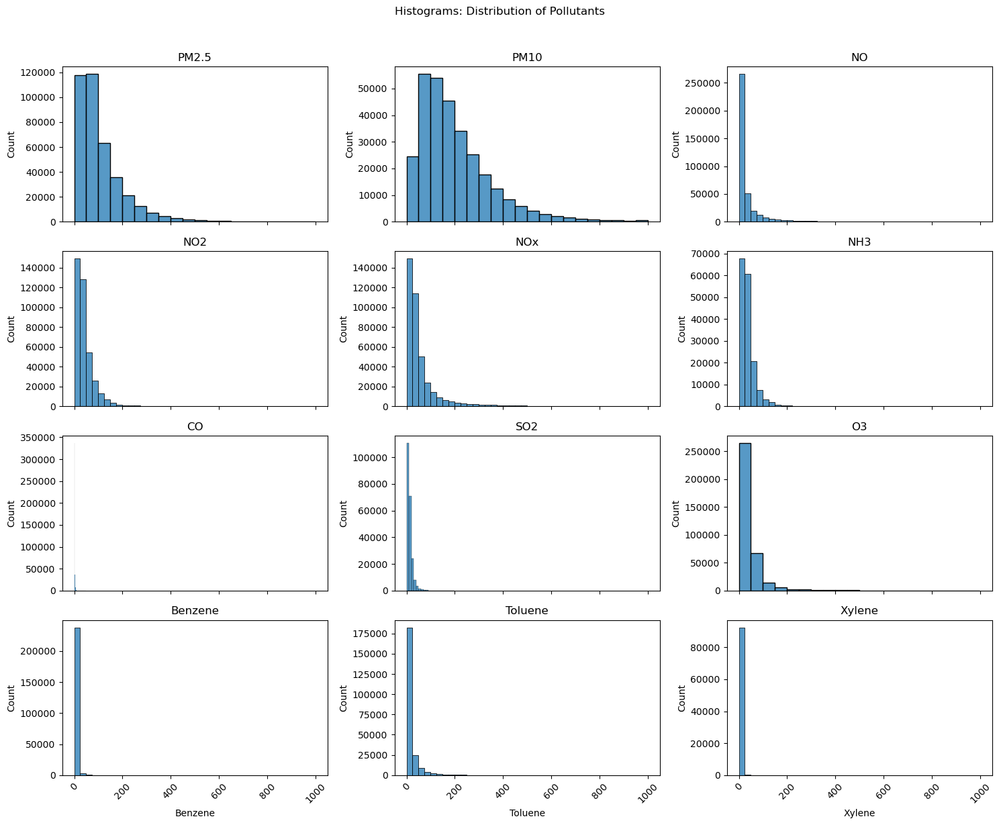

In [91]:
# Histograms: Distribution of pollutants
pollutants = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene']
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(15, 12), sharex=True)  # Use sharex to link x-axis across subplots
fig.suptitle('Histograms: Distribution of Pollutants', y=1.02)

for i, pollutant in enumerate(pollutants):
    row, col = divmod(i, 3)
    ax = axes[row, col]
    sns.histplot(df[pollutant], bins=20, kde=False, ax=ax)
    ax.set_title(pollutant)
    
    # Rotate x-axis labels
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()  # Automatically adjusts subplot parameters to avoid overlapping
plt.show()

Geospatial animation-- still working on this code block----------------

In [92]:
# Function to update the map with AQI values on each date
def update_map(date):
    # Create a folium map for each frame
    m = folium.Map(location=[df['Lat'].mean(), df['Lon'].mean()], zoom_start=10)

    # Create a MarkerCluster layer for each frame
    marker_cluster = MarkerCluster().add_to(m)
    
    # Filter data for the specific date
    filtered_data = df[df['Datetime'] == date]
    
    # Add markers to the MarkerCluster layer
    for index, row in filtered_data.iterrows():
        folium.Marker([row['Lat'], row['Lon']], 
                      popup=f'AQI: {row["AQI"]}', 
                      icon=None).add_to(marker_cluster)

    # Display the map for each frame
    display(m)

# Get unique dates for animation frames
animation_dates = df['Datetime'].unique()

# Create an animation and assign it to a variable
ani = FuncAnimation(plt.gcf(), update_map, frames=animation_dates, repeat=False)

# Display the animation
display(plt.gcf())

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [93]:
# # Create a folder to store HTML files
# html_folder = 'animation_html'
# os.makedirs(html_folder, exist_ok=True)

# # Function to create and display an animated map
# def create_animated_map():
#     # Create a folium map
#     m = folium.Map(location=[df['Lat'].mean(), df['Lon'].mean()], zoom_start=10)
    
#     # Create a MarkerCluster layer
#     marker_cluster = MarkerCluster().add_to(m)
    
#     # Add markers to the MarkerCluster layer
#     for index, row in df.iterrows():
#         folium.Marker([row['Lat'], row['Lon']], 
#                       popup=f'AQI: {row["AQI"]}', 
#                       icon=None).add_to(marker_cluster)

#     # Create a GeoJson object for animated data
#     features = []
#     for date in df['Datetime'].unique():
#         filtered_data = df[df['Datetime'] == date]
#         feature = {
#             'type': 'Feature',
#             'geometry': {
#                 'type': 'Point',
#                 'coordinates': [filtered_data['Lon'].mean(), filtered_data['Lat'].mean()],
#             },
#             'properties': {
#                 'time': date.isoformat(),
#                 'popup': f'AQI: {filtered_data["AQI"].mean()}',
#             },
#         }
#         features.append(feature)

#     animated_data = {
#         'type': 'FeatureCollection',
#         'features': features,
#     }

#     # Add TimestampedGeoJson to the map
#     TimestampedGeoJson(animated_data, period='P1D', duration='P1D', transition_time=1000).add_to(m)
    
#     # Save the map as an HTML file
#     html_filename = os.path.join(html_folder, 'animated_map.html')
#     m.save(html_filename)
    
#     # Display the HTML file
#     return html_filename

# # Create and display the animated map
# animated_map_html = create_animated_map()
# HTML(f'<iframe src={animated_map_html} width=100% height=500></iframe>')   

In [94]:
# latitude, longitude = df['Lat'].tolist(), df['Lon'].tolist()

# fig, ax = plt.subplots(figsize=(10, 8))
# ax = plt.axes(projection=ccrs.PlateCarree())
# ax.stock_img()
# sc = ax.scatter(longitude, latitude, c='red', s=50, edgecolors='k', transform=ccrs.PlateCarree())

# def update(frame):
#     sc.set_offsets(df[['Lon', 'Lat']])
#     return sc,

# ani = animation.FuncAnimation(fig, update, frames=range(len(df)), blit=True)

# # Adjust the path to save the animation file
# ani.save('animation_cartopy.gif', writer='pillow', fps=1)
# plt.show()


Frequency of AQI categories across different months:

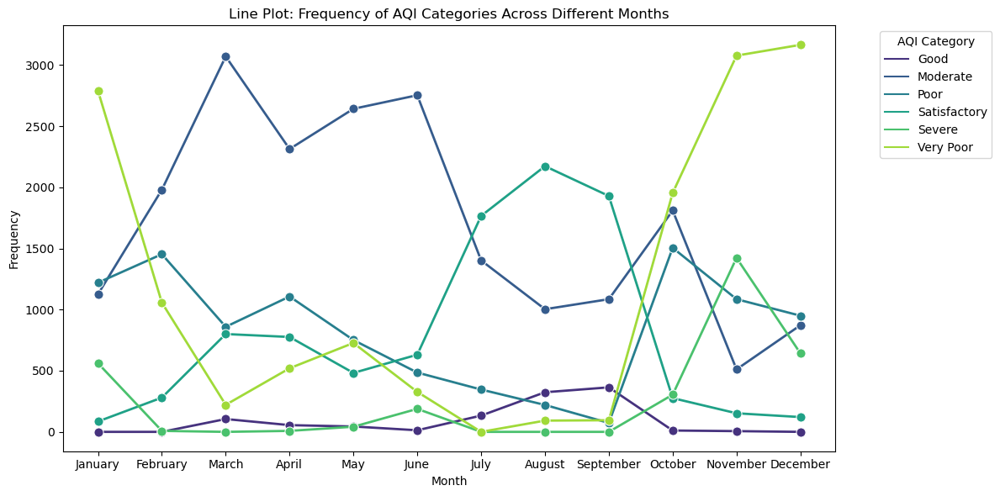

In [95]:
# Define the order of months
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

# Convert 'Month' to categorical with specified order
chart_df['Month'] = pd.Categorical(chart_df['Month'], categories=month_order, ordered=True)

# Create a DataFrame with counts
df_counts = chart_df.groupby(['Month', 'AQI_Category']).size().reset_index(name='Count')

# Line Plot: Frequency of AQI categories across different months
plt.figure(figsize=(12, 6))
sns.lineplot(x='Month', y='Count', hue='AQI_Category', data=df_counts, palette='viridis', marker='o', markersize=8, linewidth=2)
plt.title('Line Plot: Frequency of AQI Categories Across Different Months')
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.legend(title='AQI Category', bbox_to_anchor=(1.05, 1), loc='upper left')  # Move legend outside the plot
plt.tight_layout()
plt.show()

Bar Chart: Frequency of AQI categories across different months

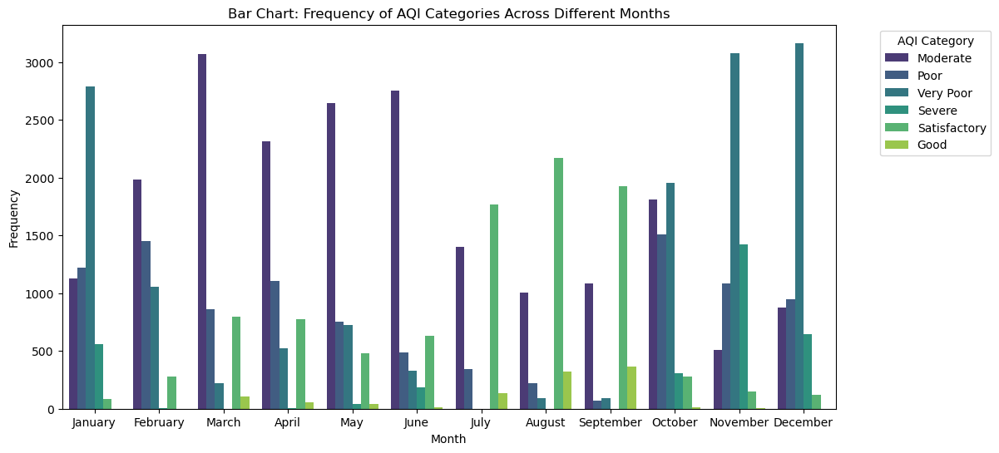

In [96]:

plt.figure(figsize=(12, 6))
sns.countplot(x='Month', hue='AQI_Category', data=chart_df, palette='viridis')
plt.title('Bar Chart: Frequency of AQI Categories Across Different Months')
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.legend(title='AQI Category', bbox_to_anchor=(1.05, 1), loc='upper left')  # Move legend outside the plot
plt.show()

Seasonal Decomposition for each station: still working on this code block

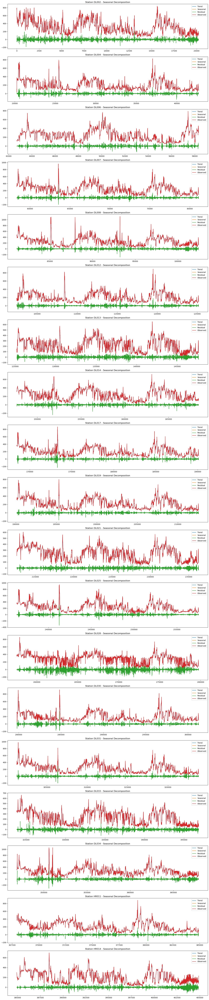

In [97]:
# Increase the chunksize
plt.rcParams['agg.path.chunksize'] = 20000

# Group by 'StationId' and perform Seasonal Decomposition for each group
grouped = df.groupby('StationId')['AQI']

# Adjust the figure size for better visibility
plt.figure(figsize=(16, 4 * len(grouped)))

for i, (station_id, group) in enumerate(grouped):
    plt.subplot(len(grouped), 1, i + 1)
    
    result = seasonal_decompose(group, model='additive', period=30)  # Adjust the period as needed
    
    plt.plot(result.trend, label='Trend')
    plt.plot(result.seasonal, label='Seasonal')
    plt.plot(result.resid, label='Residual')
    plt.plot(result.observed, label='Observed')
    
    plt.title(f'Station {station_id} - Seasonal Decomposition')
    plt.legend()

plt.tight_layout()
plt.show()

"Particulate Matter 2.5" Distribution for Different AQI Categories:

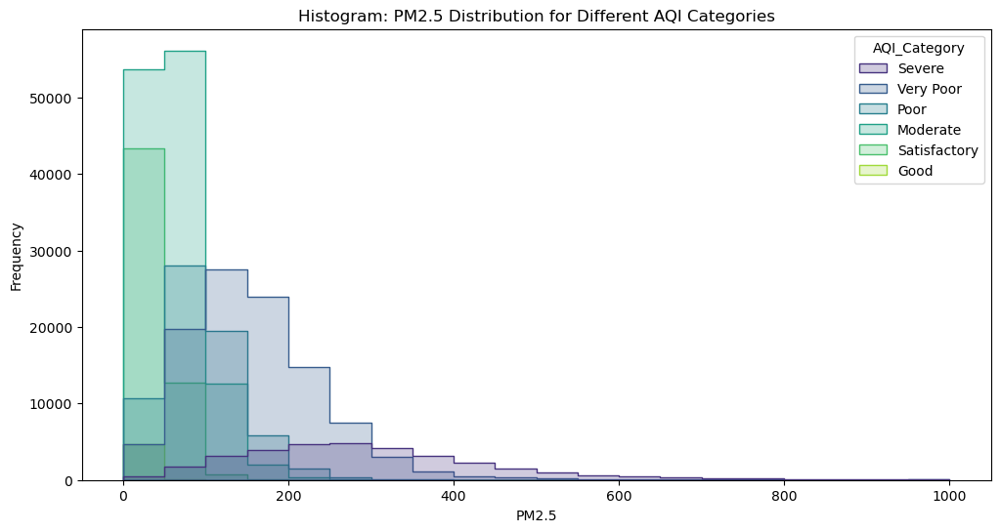

In [98]:
# Separate histograms for different AQI categories
plt.figure(figsize=(12, 6))
sns.histplot(data=df, x='PM2.5', hue='AQI_Category', element='step', common_norm=False, bins=20, palette='viridis')
plt.title('Histogram: PM2.5 Distribution for Different AQI Categories')
plt.xlabel('PM2.5')
plt.ylabel('Frequency')
plt.show()

#### Geospatial Heatmap with Folium:
AQI values across different station locations

In [101]:
# Calculate mean latitude and longitude
initial_latitude = df['Lat'].mean()
initial_longitude = df['Lon'].mean()

# Choose an initial zoom level
initial_zoom = 10  # Adjust as needed

# Create the initial map
map_air_quality = folium.Map(location=[initial_latitude, initial_longitude], zoom_start=initial_zoom)

# Create a list of lists containing Lat, Lon, and AQI values
heat_data = [[row['Lat'], row['Lon'], row['AQI']] for index, row in df.iterrows()]

# Add HeatMap layer to the map
HeatMap(heat_data).add_to(map_air_quality)

# Save the map as an HTML file
map_air_quality.save('geospatial_heatmap.html')

map_air_quality

Manually downloading the above HTML file by generating a link

In [66]:
# Specify the filename (change if needed)
filename = 'geospatial_heatmap.html'

# Save the Folium map to the specified filename
map_air_quality.save(filename)

# Create a download link for the HTML file
FileLink(filename)

NameError: name 'map_air_quality' is not defined